Your dataset: The folder 'sphaera_illustrations_dataset' contains 844 illustrations, selected from all illustrations that have been extracted from the books in the sphaera corpus 

### 1. Cryptographic hashing for duplicate detection

Datasets are never clean. In image datasets it might be a good idea to check for (exact) duplicates before starting to analyze the data.

Cryptographic hashing techniques produce a fixed size fingerprint of an inputfile in such a way, that small changes in the file result in large changes in the hash. To find identical files, we can thus compare the hashes instead of the files them selfs, which due to the small size of the hashes is much faster.

#### Task:

We have hidden on duplicate file in the datatset. To find it:

* hash all files in the dataset with the md5 hash function (use the hashlib library)
* compare the hashes to find the duplicate


In [1]:
import hashlib
import os

dataset_dir = 'sphaera_illustrations_dataset' 
hash_to_filename = {}

for filename in os.listdir(dataset_dir):
    
    if filename == '.DS_Store':
        pass # This is for Mac users. Do nothing if your folder contains the notorious .DS_Store file
        
    else:
        filepath = os.path.join(dataset_dir, filename)
        filehash = hashlib.md5(open(filepath,  'rb').read()).hexdigest()
        
        if filehash in hash_to_filename.keys():
            print('We found a duplicate pair: {} and {}'.format(filename, hash_to_filename[filehash]))
        else: 
            hash_to_filename[filehash] = filename

We found a duplicate pair: 1111_johannnes_dolius_libro_meo_1540_p102_92,265,399,456.jpg and 1886_sacrobosco_libelus_1540_p102_92,265,399,456.jpg


### 2. Hash an image

In image hashing or fingerprinting, opposed to cryptographic hashing we want to produce fingerprints which are not very sensitive to little changes such that similar images produce similar hashes.

#### Task:

To hash an image: 

* Read in "2106_sacrobosco_sphaera_1561_p25_348,1242,509,433.jpg" with PIL. Have a look at the image.
* Convert to grayscale
* Scale to 8x 8 pixel
* Compute the mean pixe intensity (hint: use numpy)
* Convert every pixel with less than mean intensity to black and every pixel grater equal than than mean intensity to white
* Visualize result
* Flatten the resulting image

If you succeed you have created your first image hash. This particular has function is called average hash

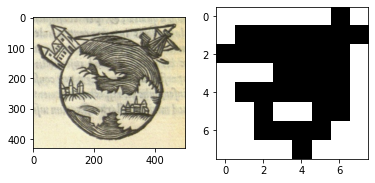

Here is our first image hash: [1 1 1 1 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 0 0 0 1 1 0 0 0 0
 0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 0 1 1 1 1 1 1 0 1 1 1]


In [3]:
from PIL import Image, ImageOps
import numpy as np
from matplotlib import pyplot as plt


def get_avarage_hash(filename):
    
    filepath = os.path.join(dataset_dir, filename)
    img = Image.open(filepath)
    img2 = ImageOps.grayscale(img)
    img3 = img2.resize((8,8))

    avarage_hash = np.where(img3 > np.array(img3).mean(), 1, 0)

    return img, avarage_hash


img_1, avarage_hash_1 = get_avarage_hash("1701_sacrobosco_sphaera_1550_p40_395,1295,501,430.jpg")

fig, (ax1, ax2) = plt.subplots(1, 2)
ax1.imshow(img_1, cmap='gray')
ax2.imshow(avarage_hash_1, cmap='gray')
plt.show()

print('Here is our first image hash: {}'.format(avarage_hash_1.flatten()))

### 3. Compare  images via their hashes

#### Task:

* Calculate and visualize the average hash for "2106_sacrobosco_sphaera_1561_p25_348,1242,509,433.jpg" 
* Compare it to the hash calculated before, visualize the pixels where the two hashes are different.



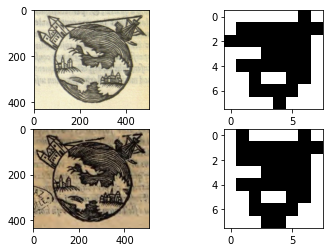

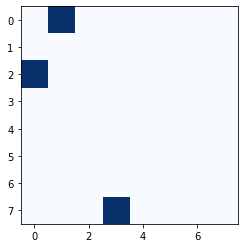

In [4]:
img_2, avarage_hash_2 = get_avarage_hash("2106_sacrobosco_sphaera_1561_p25_348,1242,509,433.jpg")

fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2)
ax1.imshow(img_1, cmap='gray')
ax2.imshow(avarage_hash_1, cmap='gray')
ax3.imshow(img_2, cmap='gray')
ax4.imshow(avarage_hash_2, cmap='gray')
plt.show()

diff = avarage_hash_1 == avarage_hash_2
plt.imshow(diff, cmap="Blues_r")
plt.show()

With the average hash we have indeed engineered a function that has  mapped our two _visually_ similar imaged onto two representation that are indeed _bitwise_ similar

### 4. Use image hashing to find  images in the corpus that are similar to a given image.

#### Task:

Find all images in the corpus whose average hashes differ from that of our original image ("2106_sacrobosco_sphaera_1561_p25_348,1242,509,433.jpg") by no more than 10 bit.

1972_vinet_sphaera_1620_p82


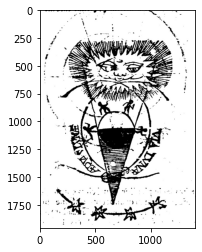

1743_sacrobosco_sphaera_1587_p23


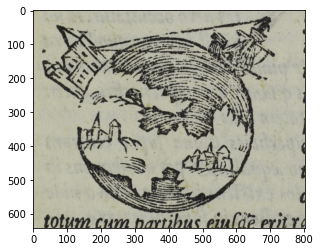

1691_sacrobosco_sphere_1546_p17


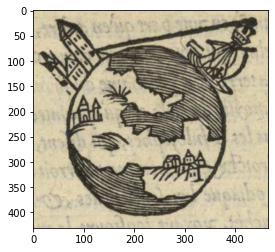

2168_peucer_elementa_1558_p112


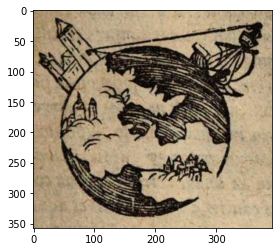

2176_blebel_libellus_1588_p45


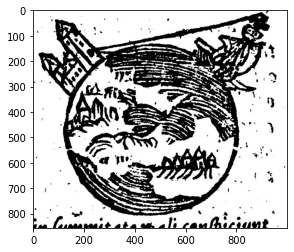

1727_sacrobosco_sphaera_1567_p29


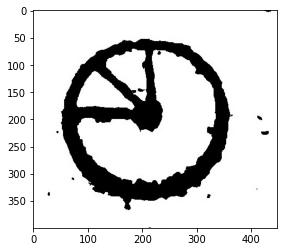

1753_sacrobosco_libellus_1601_p36


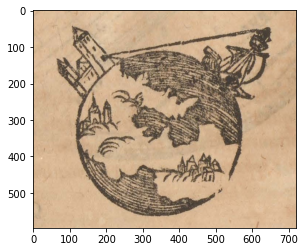

2182_blebel_libellus_1603_p44


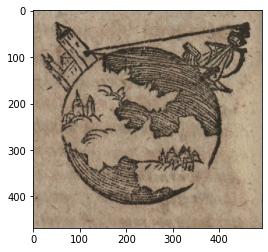

1974_vinet_sphaera_1569_p82


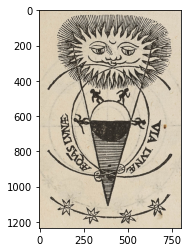

2173_peucer_elementa_1601_p111


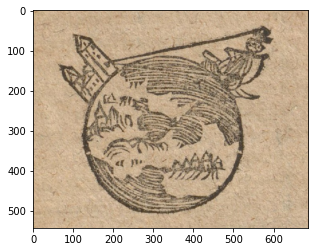

1760_sacrobosco_sphere_1619_p116


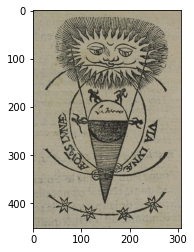

1760_sacrobosco_sphere_1619_p39


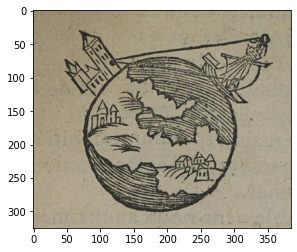

1701_sacrobosco_sphaera_1550_p40


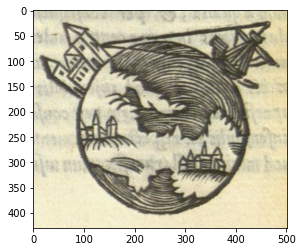

1882_sacrobosco_liber_1536_p39


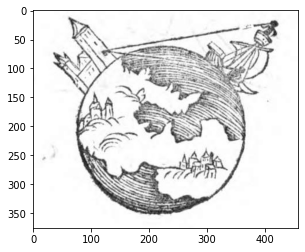

1911_nunes_sphaera_1572_p16


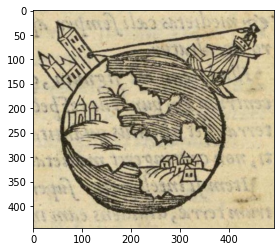

1967_sacrobosco_sphaera_1606_p33


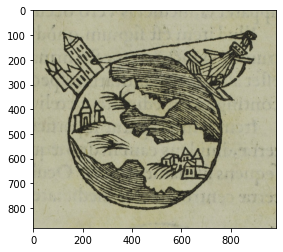

1964_vinet_sphaera_1558_p88


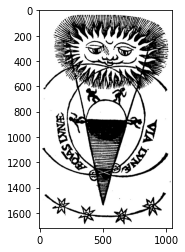

1711_vinet_sphaera_1557_p27


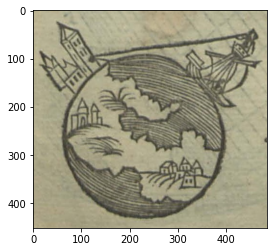

1934_sacrobosco_sphaera_1551_p18


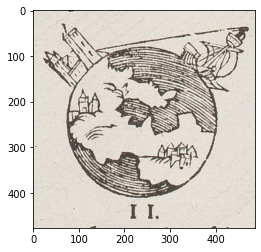

2165_peucer_elementa_1553_p117


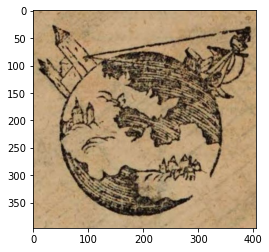

1902_vinet_sphaera_1552_p55


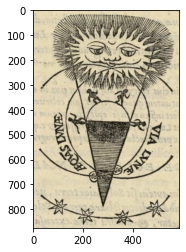

1881_melanchthon_liber_1534_p23


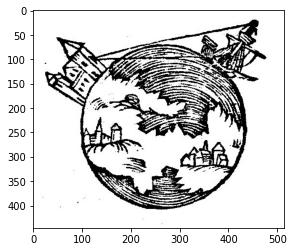

1897_sacrobosco_libellus_1574_p36


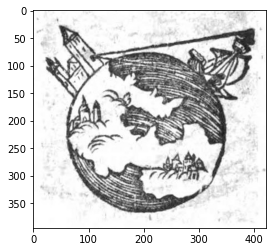

2167_peucer_elementa_1569_p199


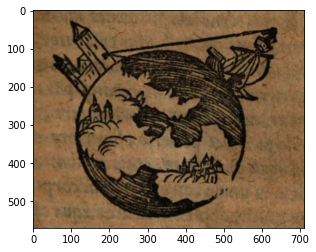

1708_vinet_sphaera_1556_p28


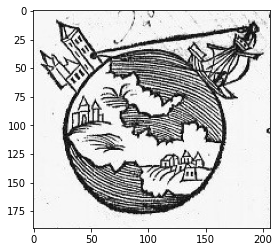

1902_vinet_sphaera_1552_p21


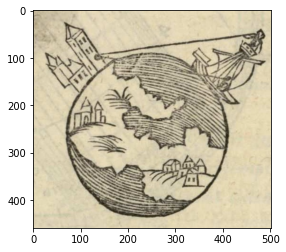

1912_nunes_sphaera_1564_p95


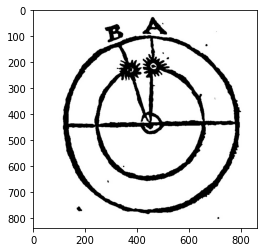

2172_peucer_elementa_1554_p68


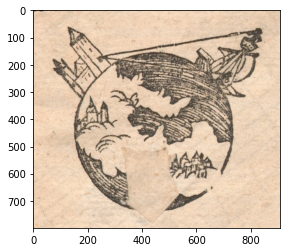

1758_desbordes_sphere_1616_p18


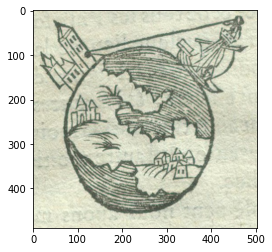

1974_vinet_sphaera_1569_p34


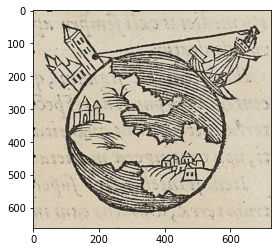

2164_blebel_quaestiones_1605_p122


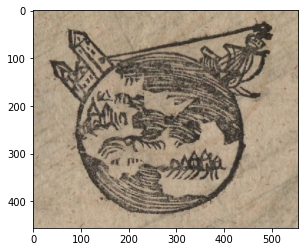

1707_sacrobosco_sphaera_1554_p22


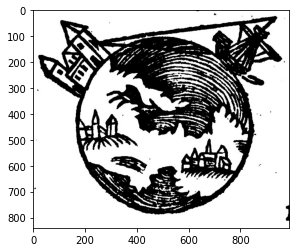

1793_sacrobosco_trattato_1543_p18


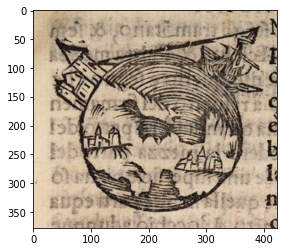

1892_farghani_sphaera_1549_p37


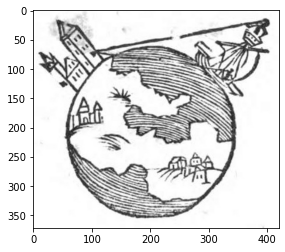

1733_sacrobosco_sphere_1576_p18


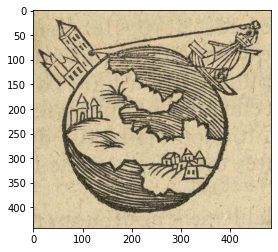

2179_blebel_libellus_1611_p47


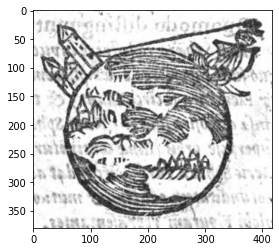

1958_vinet_sphaera_1582_p45


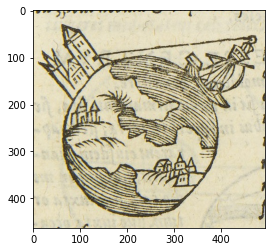

1879_melanchthon_liber_1532_p33


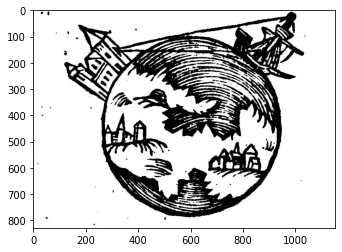

1737_sacrobosco_sphaera_1580_p11


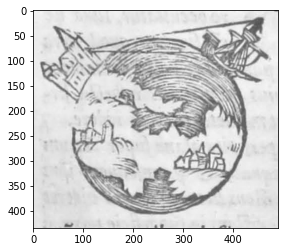

2181_blebel_libellus_1595_p43


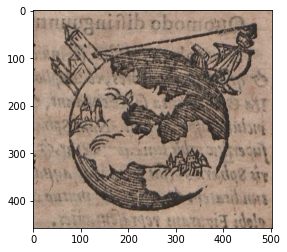

1904_melanchthon_libellus_1563_p37


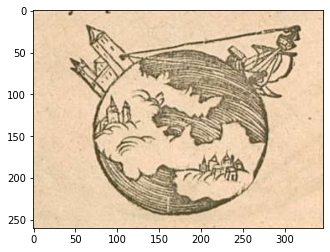

2175_blebel_libellus_1598_p47


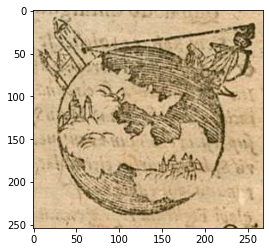

2162_dietrich_quaestiones_1578_p127


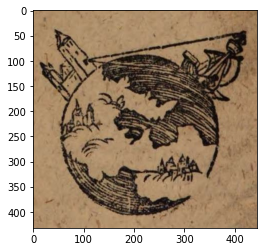

1898_melanchthon_libellus_1578_p37


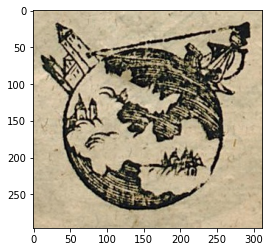

1857_giuntini_sphaera_1566_p44


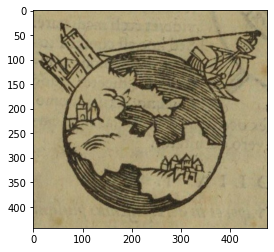

1708_vinet_sphaera_1556_p91


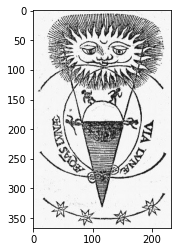

1692_sacrobosco_sphaera_1547_p20


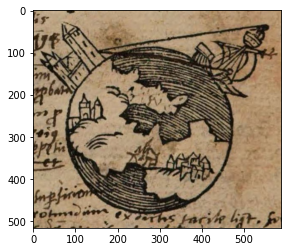

2160_dietrich_quaestiones_1564_p129


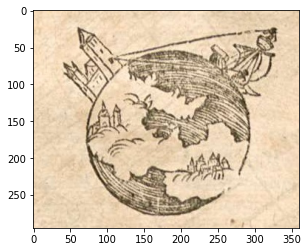

1872_sacrobosco_emendata_1617_p38


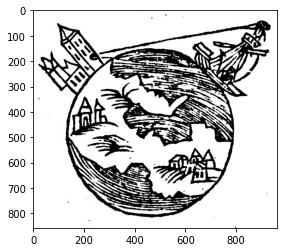

2219_sacrobosco_sphaera_1552_p13


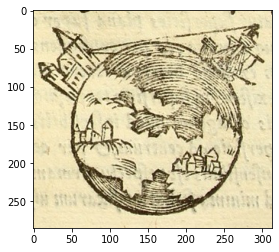

1851_giuntini_sphaeram_1577_p375


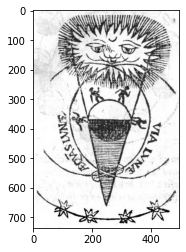

1852_sacrobosco_commentaria_1578_p189


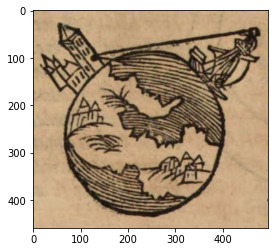

1684_sacrobosco_libellus_1543_p20


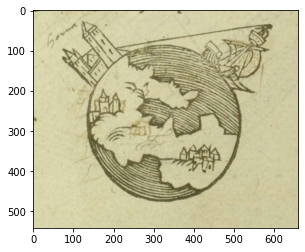

1838_sacrobosco_sphere_1570_p38


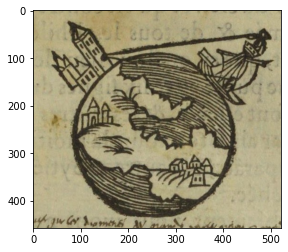

1963_sacrobosco_sphaera_1608_p60


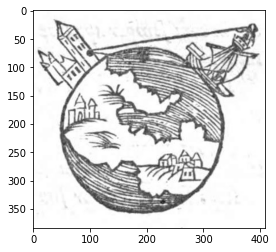

1912_nunes_sphaera_1564_p45


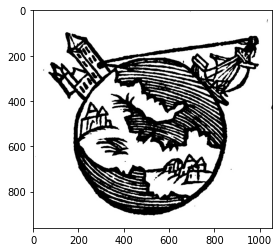

1734_sacrobosco_sphaera_1577_p16


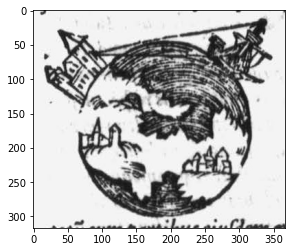

2161_dietrich_quaestiones_1573_p129


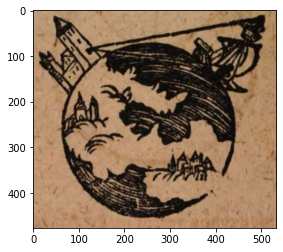

1739_desbordes_sphere_1584_p41


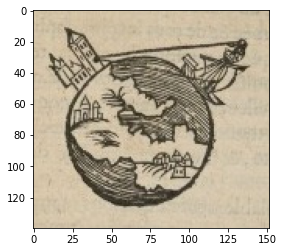

1690_sacrobosco_libellus_1545_p41


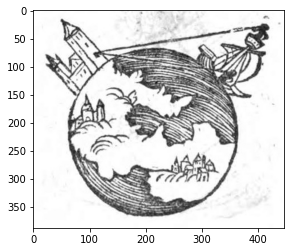

1715_sacrobosco_sphaera_1561_p11


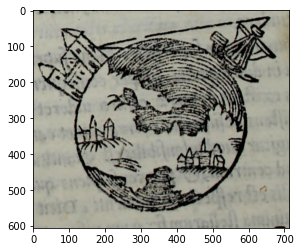

1968_vinet_sphaera_1567_p45


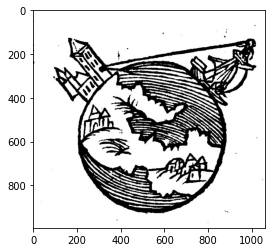

1885_sacrobosco_sphaera_1538_p43


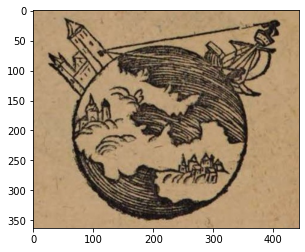

2183_blebel_libellus_1616_p52


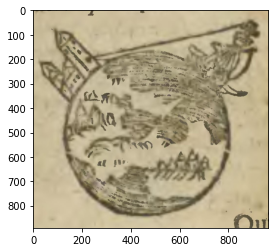

2190_giuntini_speculum_1583_p621


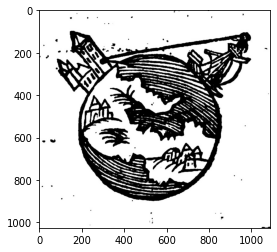

1903_sacrobosco_libellvs_1561_p33


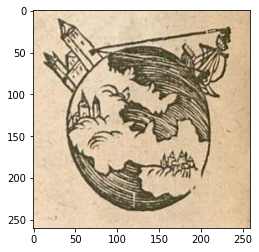

1955_Sphaera_Comp_Cavellat_1561_p35


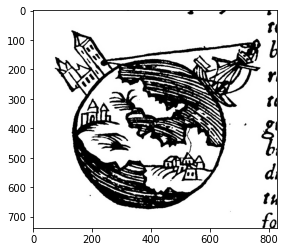

1716_ruffaut_sphaera_1561_p24


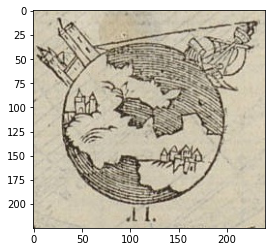

1687_sacrobosco_liber_1545_p20


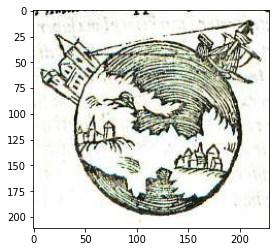

1854_giuntini_sfera_1582_p87


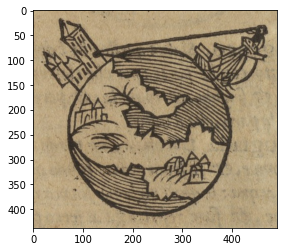

1752_sacrobosco_sphaera_1601_p10


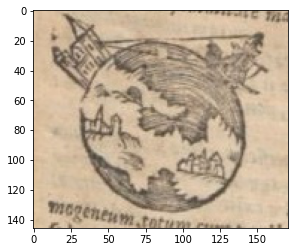

1890_melanchthon_typis_1550_p37


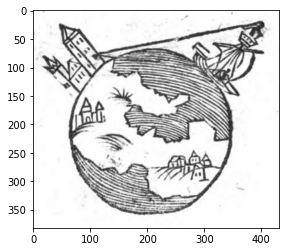

2159_dietrich_quaestiones_1583_p123


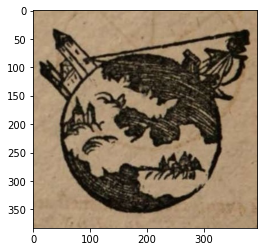

1894_melanchthon_libellus_1549_p37


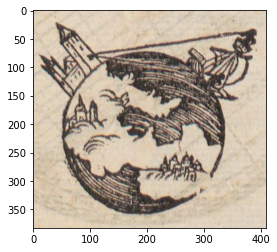

2157_dietrich_quaestiones_1570_p124


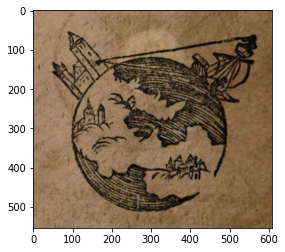

2163_dietrich_quaestiones_1591_p125


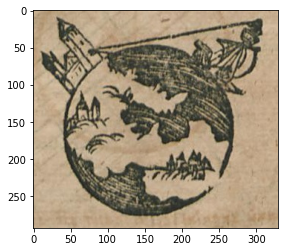

1952_vinet_sphaera_1551_p49


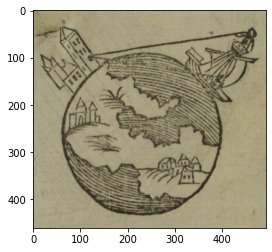

1712_sacrobosco_sphaera_1559_p22


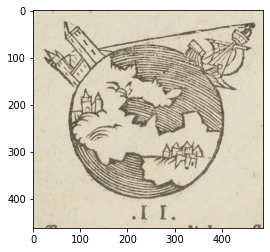

1969_vinet_sphaera_1562_p39


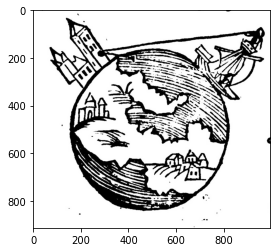

1884_melanchthon_liber_1537_p24


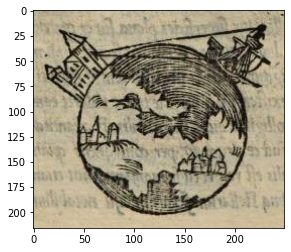

2198_sacrobosco_sphaera_1547_p23


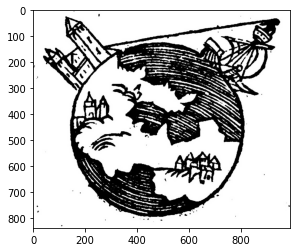

2106_sacrobosco_sphaera_1561_p25


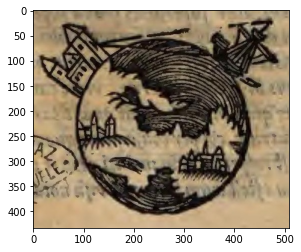

1748_sacrobosco_sphaera_1594_p12


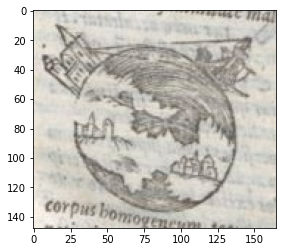

2166_peucer_elementa_1563_p244


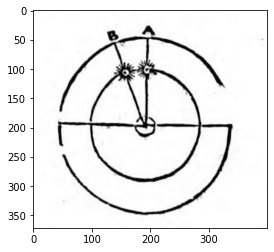

1951_valeriano_sphaera_1550_p43


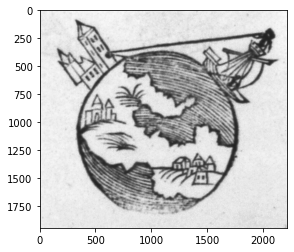

2203_giuntini_commentaria_1577_p193


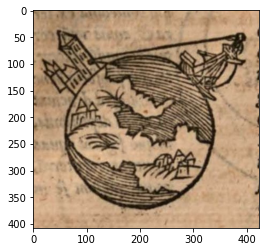

1838_sacrobosco_sphere_1570_p115


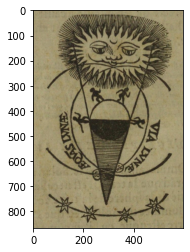

2170_peucer_elementa_1551_p117


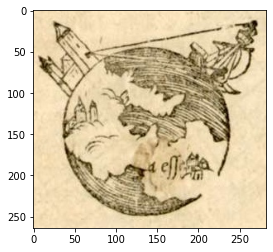

1883_melanchthon_liber_1537_p19


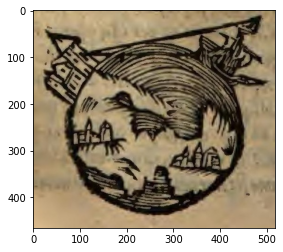

1962_vinet_sphaera_1619_p27


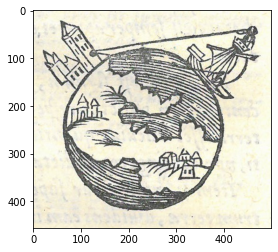

1733_sacrobosco_sphere_1576_p57


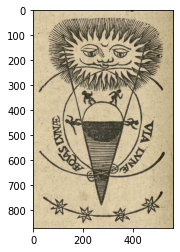

1900_sacrobosco_libellvs_1553_p34


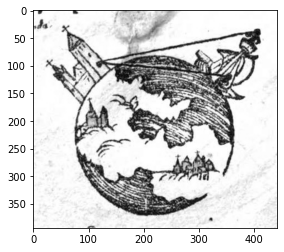

1895_melanchthon_libellus_1550_p41


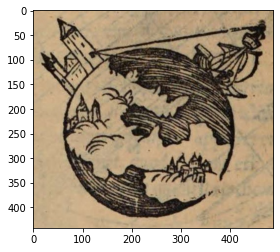

2112_sacrobosco_liber_1553_p6


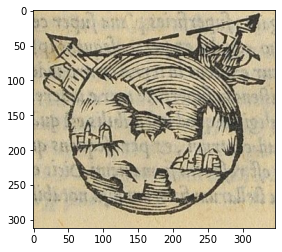

2258_giuntini_speculum_1581_p608


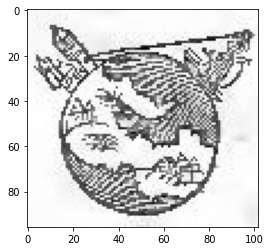

2091_melanchthon_sphaera_1531_p33


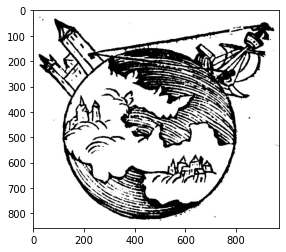

1901_melanchthon_liber_1541_p23


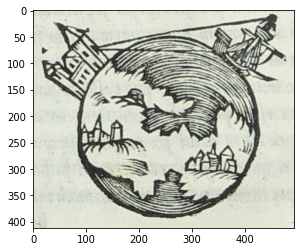

1729_sacrobosco_sphaera_1572_p12


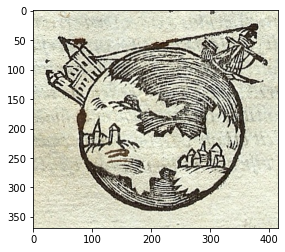

1854_giuntini_sfera_1582_p361


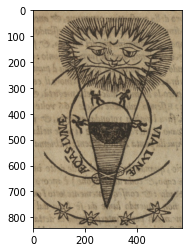

2115_blebel_libellus_1629_p57


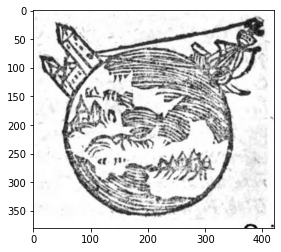

1968_vinet_sphaera_1567_p95


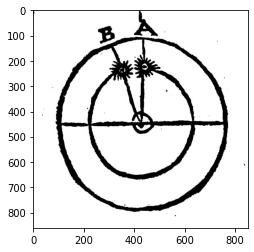

1891_sacrobosco_libellvs_1558_p34


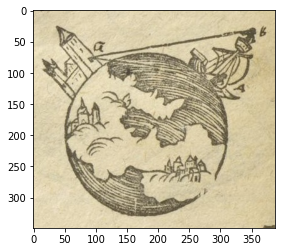

1964_vinet_sphaera_1558_p25


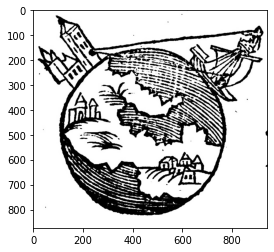

1896_sacrobosco_libellus_1568_p36


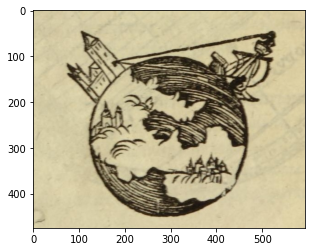

1730_giuntini_sphaera_1573_p38


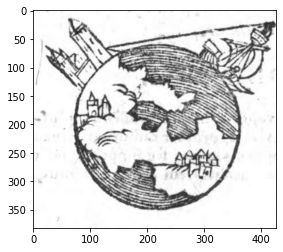

1741_sacrobosco_sphaera_1594_p88


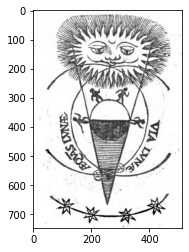

1970_sacrobosco_sphaera_1577_p32


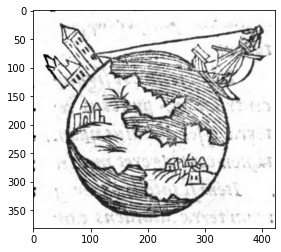

1973_sacrobosco_sphaera_1564_p36


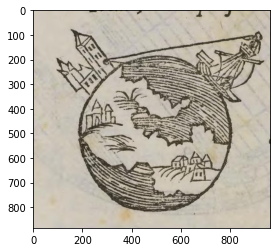

1710_sacrobosco_sphaera_1557_p26


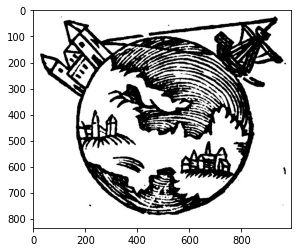

2240_dodoens_isagoge_1548_p55


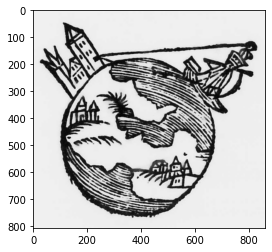

2169_peucer_elementa_1576_p114


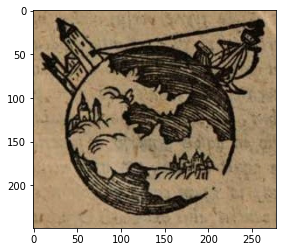

1695_sacrobosco_sphaera_1548_p24


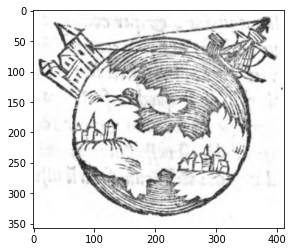

2177_blebel_libellus_1590_p49


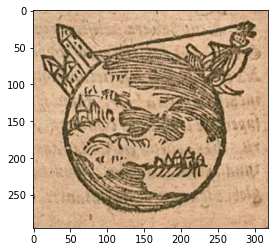

1856_sacrobosco_sphaera_1566_p42


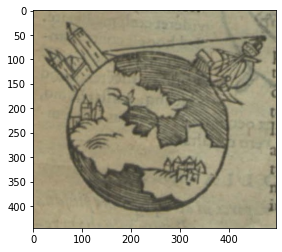

2178_blebel_libellus_1582_p44


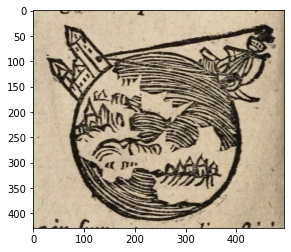

1754_desbordes_augmentee_1607_p40


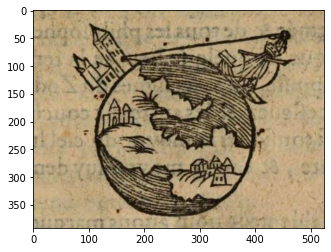

1855_giuntini_sphaera_1578_p38


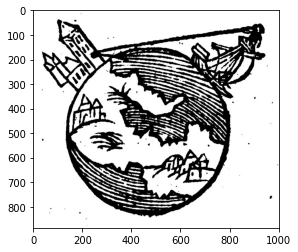

1886_sacrobosco_libelus_1540_p39


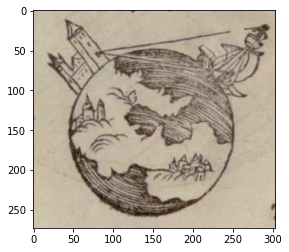

1887_sacrobosco_liber_1543_p18


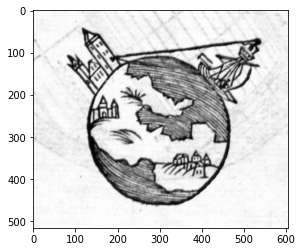

2166_peucer_elementa_1563_p113


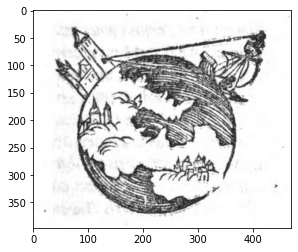

2171_peucer_elementa_1587_p118


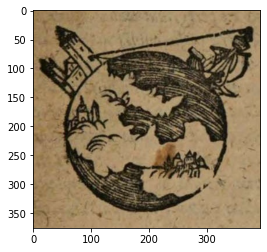

1880_sacrobosco_liber_1534_p33


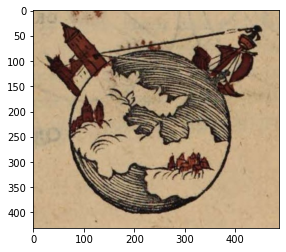

1741_sacrobosco_sphaera_1594_p30


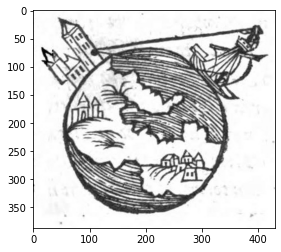

1682_sacrobosco_liber_1541_p21


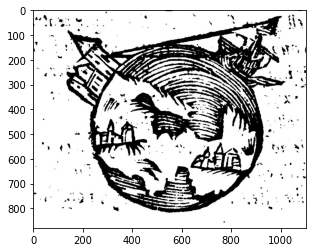

1688_sacrobosco_sphaera_1545_p46


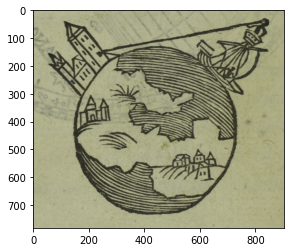

In [25]:
import re

for filename in os.listdir(dataset_dir):
    
    if filename == '.DStore':
        pass
    
    else:
        img , avarage_hash = get_avarage_hash(filename)
        hamming_dist = np.count_nonzero(avarage_hash_1.flatten() != avarage_hash.flatten())
        
        if hamming_dist  <= 10:
            
            print(re.sub(r'_\d*,.*', '', filename))
            filepath = os.path.join(dataset_dir, filename)
            img = Image.open(filepath)
            plt.imshow(img, cmap='gray')
            plt.show()

This is the basic idea of finding similar images by means of image hashing. Of course there is a lot we can do to improve. In our case for instance we are only interested in what was actually printed, and not in the background information such as paper color or texture. We should thus for instance convert to black and white before comparing.

Also there are image hashing functions such as the perceptual hash, which, depending on the nature of your data, may be better suited. Of course there is a library for everything in Python, so you do not have to implement them yourself. Have a look at: https://pypi.org/project/ImageHash/ 

### 5. Limits of image hashing 

Image hashing is a quick solution for retrieving similar images, but it is also rather crude with some severe limitation. Thus it is not invariant against translations or rotations of the images, which however, is often desirable when searching for similar imaged. It its also for instance not sensitive to the similarity between and image and parts thereof, for instance different crops.

#### Task:
* take our original image ("2106_sacrobosco_
sphaera_1561_p25_348,1242,509,433.jpg" ) and cut of a quarter of its width on the right
* calculate the average hash and compare to the average hash of the original



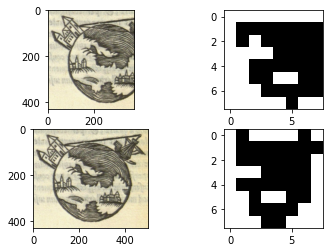

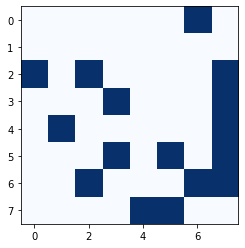

The original and the cropped image differ by 16 bits.


In [31]:
new_width = int(np.array(img_1).shape[1] - np.array(img_1).shape[1]/4)
img_cut = np.array(img_1)[:,:new_width]

img2 = ImageOps.grayscale(Image.fromarray(img_cut))
img3 = img2.resize((8,8))
avarage_hash_4 = np.where(img3 > np.array(img3).mean(), 1, 0)

fig, ((ax1, ax2),(ax3, ax4)) = plt.subplots(2, 2)
ax1.imshow(img_cut, cmap='gray')
ax2.imshow(avarage_hash_4, cmap='gray')
ax3.imshow(img_1, cmap='gray')
ax4.imshow(avarage_hash_2, cmap='gray')
plt.show()

diff = avarage_hash_1 == avarage_hash_4
plt.imshow(diff, cmap="Blues_r")
plt.show()

hamming_dist = np.count_nonzero(avarage_hash_1.flatten() != avarage_hash_4.flatten())
print('The original and the cropped image differ by {} bits.'.format(hamming_dist))

#### Additional task: 
* Go back to 4. and find all images whose avarage hashes differ from that of our original image by 16 or less bits

# Keypoint/feature detection and matching

### Fingerprint matching as a blueprint for the approach
|  |  |  |
|---|---|---|
||<img src=fingerprint.jpg>||
|&nbsp;|<small>Srinivasan, Harish & J. Beal, Matthew & Srihari, Sargur. (2005). Machine learning approaches for person identification and verification. Proceedings of SPIE - The International Society for Optical Engineering. 5778.</small>|&nbsp;|

* find robust features in finger ridge patterns (minutae, e.g. ridge endings or bifurcations) 
* match features
* count the number of matches

> ... the probability that a fingerprint with 36 minutiae points will share 12 minutiae points with another arbitrarily chosen fingerprint with 36 minutiae points is 6.10 × 10<sup>−8</sup>.

 
<small>Sharath Pankanti, Salil Prabhakar, and Anil K. Jain. 2002. On the Individuality of Fingerprints. IEEE Trans. Pattern Anal. Mach. Intell. 24, 8 (August 2002), 1010-1025. </small>


### 1. Keypoint extraction

#### Task:

* Read in "1852_sacrobosco_commentaria_1578_p215_498,157,604,604.jpg", find robust keypoints and visualize some of them

A number of algorithms for local feature detection and description are available, e.g. SURF (speeded up robust features) and SIFT (scale-invariant feature transform). ORB (Oriented FAST and rotated BRIEF) is a free alternative, part of the openCV computer vision library. A good introduction to keypoint extraction and matching can be found here: https://docs.opencv.org/master/db/d27/tutorial_py_table_of_contents_feature2d.html

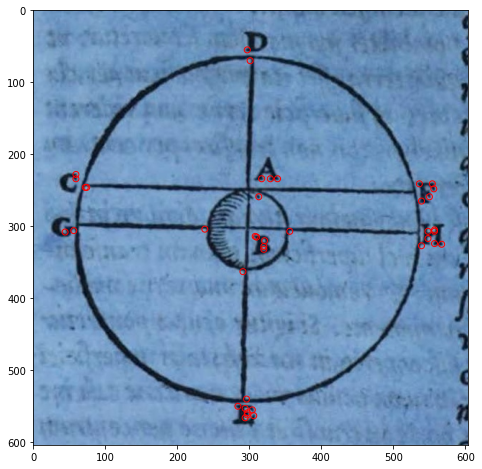

In [175]:
import cv2

orb = cv2.ORB_create()
filepath = os.path.join(dataset_dir, '1852_sacrobosco_commentaria_1578_p215_498,157,604,604.jpg')
img_1 = cv2.imread(filepath)

kp1, des1 = orb.detectAndCompute(img_1,None)
pts = np.array([kp1[i].pt for i in range(0, len(kp1))]).reshape(-1, 2)
plt.figure(figsize=(8,8))
plt.scatter(pts[:40,0],pts[:40,1], marker='o', facecolors='none', edgecolors='r')
plt.imshow(img_1) 
plt.show()

#### Task:

* find keypoints and descriptors for a second image "2203_giuntini_commentaria_1577_p219_523,108,502,507.jpg"
* match the keypoints between the two images (use BFMatcher https://docs.opencv.org/4.5.2/d3/da1/classcv_1_1BFMatcher.html)
* visualize the 20 best matches

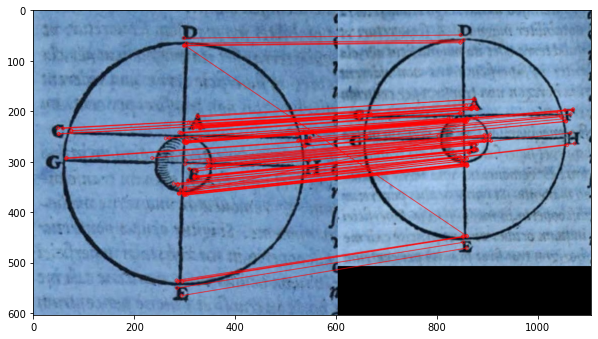

In [176]:
filepath = os.path.join(dataset_dir, '2203_giuntini_commentaria_1577_p219_523,108,502,507.jpg')
img_2 = cv2.imread(filepath)

kp2, des2 = orb.detectAndCompute(img_2,None)

bf = cv2.BFMatcher(cv2.NORM_HAMMING , crossCheck=True)
matches = bf.match(des1,des2)
matches = np.array(sorted(matches, key = lambda x:x.distance))
img_matches = cv2.drawMatches(img_1,kp1,img_2,kp2,matches[0:100], None, matchColor = (255,0,0),flags=2)
plt.figure(figsize=(10,10))
plt.imshow(img_matches)
plt.show()

There are a number of ways to go from here. A simple one is to count the number of good matches between to images of a certain quality.

#### Task:

* match the features of "1959_vinet_sphaera_1594_p112_119,82,560,695.jpg" as a reference file to the features of every other image in your dataset
* count the number of good matches (match.distance <50)
* visualize the images that have at least 50 good keypoint matches with the reference file

sphaera_illustrations_dataset/1838_sacrobosco_sphere_1570_p119_435,825,691,838.jpg


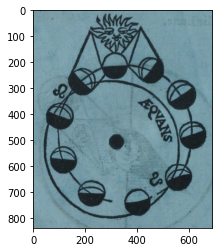

sphaera_illustrations_dataset/1885_sacrobosco_sphaera_1538_p105_261,87,551,679.jpg


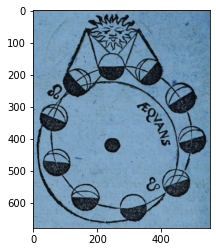

sphaera_illustrations_dataset/1970_sacrobosco_sphaera_1577_p82_201,134,563,715.jpg


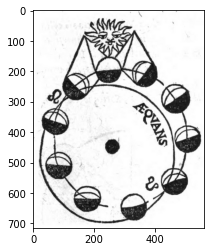

sphaera_illustrations_dataset/1688_sacrobosco_sphaera_1545_p109_449,995,1202,1472.jpg


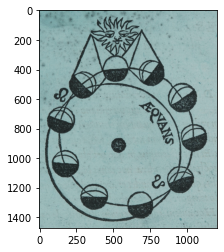

sphaera_illustrations_dataset/1960_vinet_sphaera_1581_p112_132,134,547,681.jpg


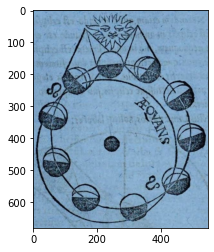

sphaera_illustrations_dataset/1851_giuntini_sphaeram_1577_p374_218,91,584,735.jpg


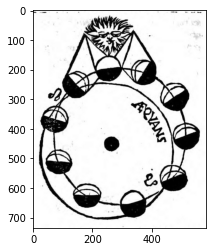

sphaera_illustrations_dataset/1887_sacrobosco_liber_1543_p49_373,182,804,864.jpg


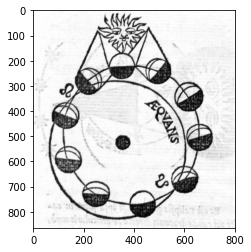

sphaera_illustrations_dataset/1857_giuntini_sphaera_1566_p123_493,226,664,841.jpg


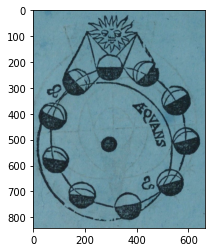

sphaera_illustrations_dataset/1691_sacrobosco_sphere_1546_p48_298,577,629,806.jpg


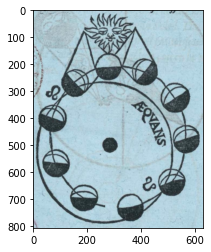

sphaera_illustrations_dataset/1892_farghani_sphaera_1549_p105_284,404,580,742.jpg


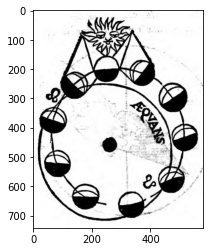

sphaera_illustrations_dataset/1974_vinet_sphaera_1569_p84_354,275,917,1182.jpg


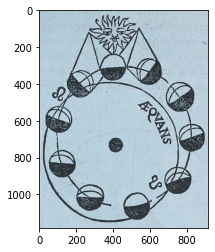

sphaera_illustrations_dataset/1741_sacrobosco_sphaera_1594_p90_184,153,587,731.jpg


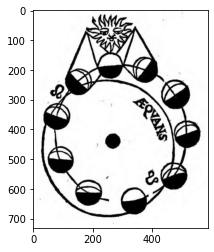

sphaera_illustrations_dataset/1820_clavius_sphaera_1601_p150_98,381,492,611.jpg


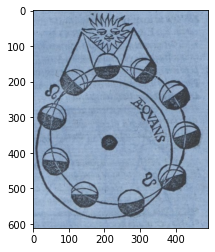

sphaera_illustrations_dataset/1861_gramminaeus_uberior_1567_p292_172,125,613,760.jpg


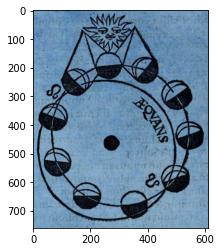

sphaera_illustrations_dataset/1902_vinet_sphaera_1552_p56_412,238,685,833.jpg


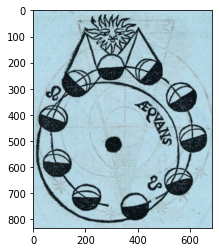

sphaera_illustrations_dataset/1888_melanchthon_libellus_1543_p96_113,260,630,774.jpg


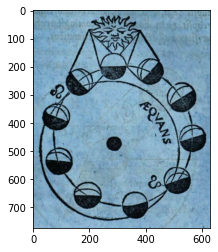

sphaera_illustrations_dataset/1900_sacrobosco_libellvs_1553_p99_171,252,562,692.jpg


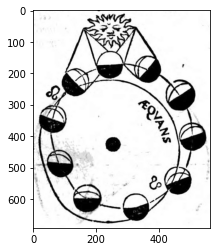

sphaera_illustrations_dataset/1953_vinet_sphaera_1566_p110_398,222,1033,1264.jpg


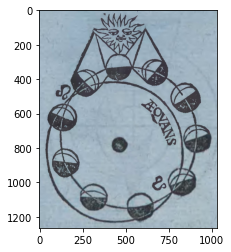

sphaera_illustrations_dataset/1963_sacrobosco_sphaera_1608_p110_201,189,557,703.jpg


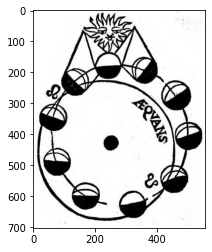

sphaera_illustrations_dataset/1890_melanchthon_typis_1550_p105_297,447,574,726.jpg


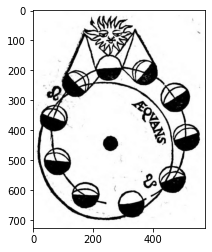

sphaera_illustrations_dataset/1882_sacrobosco_liber_1536_p91_286,86,656,742.jpg


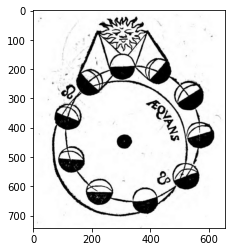

sphaera_illustrations_dataset/1754_desbordes_augmentee_1607_p121_314,780,600,719.jpg


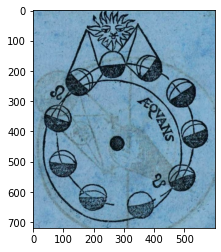

sphaera_illustrations_dataset/1711_vinet_sphaera_1557_p92_162,168,631,789.jpg


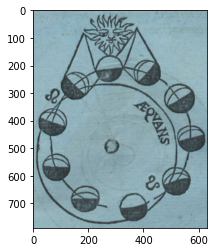

sphaera_illustrations_dataset/1959_vinet_sphaera_1594_p112_119,82,560,695.jpg


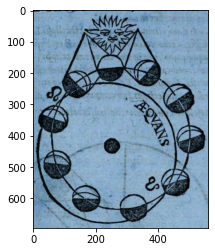

sphaera_illustrations_dataset/1957_clavius_sphaera_1610_p169_355,170,554,687.jpg


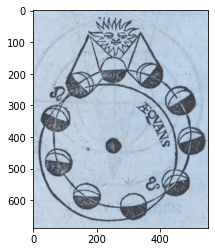

sphaera_illustrations_dataset/1962_vinet_sphaera_1619_p52_1576,225,672,845.jpg


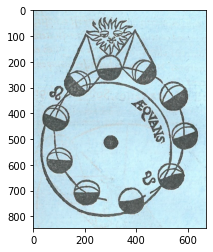

sphaera_illustrations_dataset/1690_sacrobosco_libellus_1545_p108_100,234,593,739.jpg


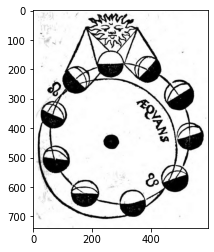

sphaera_illustrations_dataset/1911_nunes_sphaera_1572_p41_1553,101,716,850.jpg


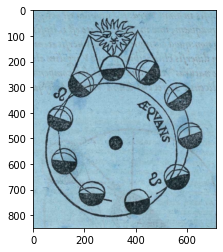

sphaera_illustrations_dataset/1961_vinet_sphaera_1591_p116_166,192,436,541.jpg


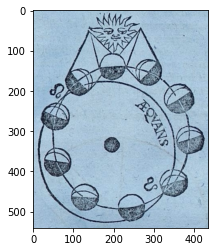

sphaera_illustrations_dataset/1851_giuntini_sphaeram_1577_p428_160,763,575,730.jpg


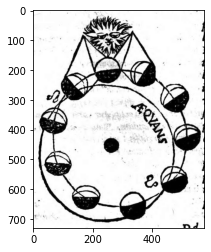

sphaera_illustrations_dataset/1952_vinet_sphaera_1551_p119_466,272,666,809.jpg


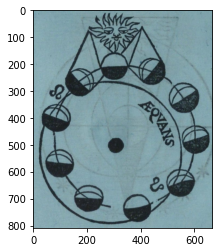

In [267]:
filepath = os.path.join(dataset_dir, '1959_vinet_sphaera_1594_p112_119,82,560,695.jpg')
img_1 = cv2.imread(filepath)

kp1, des1 = orb.detectAndCompute(img_1,None)


for j, filename in enumerate(os.listdir(dataset_dir)):
    
    if filename == '.DStore':
        pass
    
    else:
        #print(j, end='\r')
        filepath = os.path.join(dataset_dir, filename)
        img_2 = cv2.imread(filepath)

        kp2, des2 = orb.detectAndCompute(img_2,None)
        matches, good = bf.match(des1,des2), []
    
        for m in matches:
            if m.distance < 50:
                good.append(m)
                
        if len(good) > 50:
            print(filepath)
            #img = Image.open(filepath)
            plt.imshow(img_2)
            plt.show()

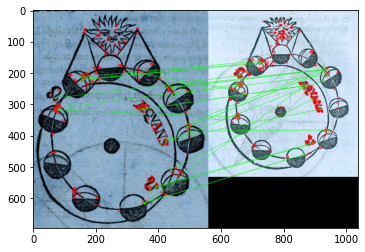

similar to 1904_melanchthon_libellus_1563_p102_50,265,478,532.jpg


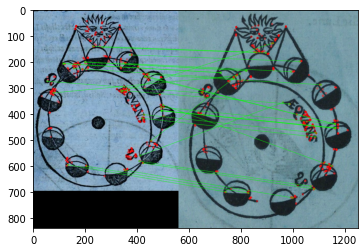

similar to 1838_sacrobosco_sphere_1570_p119_435,825,691,838.jpg


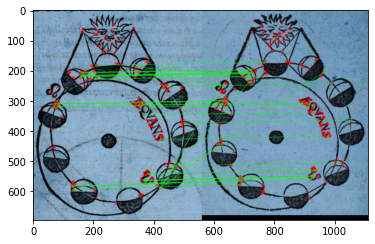

similar to 1885_sacrobosco_sphaera_1538_p105_261,87,551,679.jpg


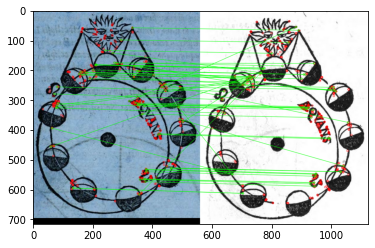

similar to 1970_sacrobosco_sphaera_1577_p82_201,134,563,715.jpg


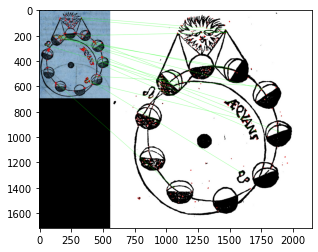

similar to 1968_vinet_sphaera_1567_p135_382,228,1587,1716.jpg


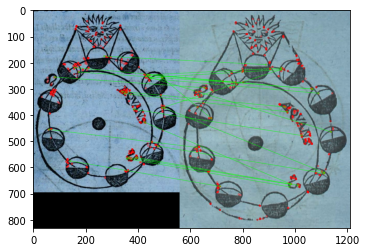

similar to 1856_sacrobosco_sphaera_1566_p122_301,136,651,831.jpg


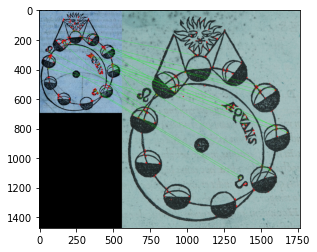

similar to 1688_sacrobosco_sphaera_1545_p109_449,995,1202,1472.jpg


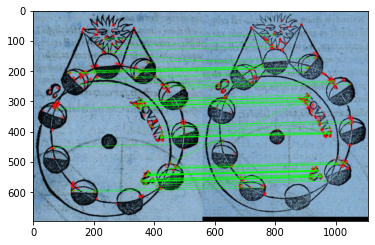

similar to 1960_vinet_sphaera_1581_p112_132,134,547,681.jpg


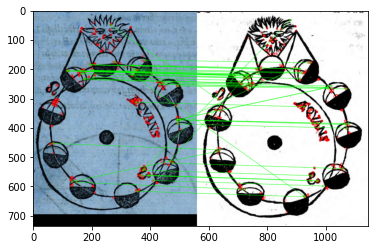

similar to 1851_giuntini_sphaeram_1577_p374_218,91,584,735.jpg


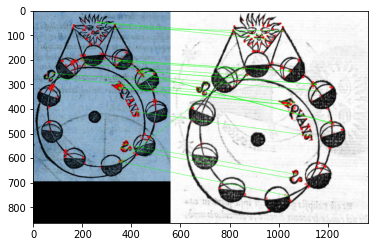

similar to 1887_sacrobosco_liber_1543_p49_373,182,804,864.jpg


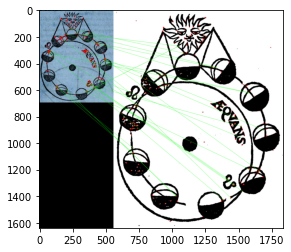

similar to 1964_vinet_sphaera_1558_p90_321,392,1275,1638.jpg


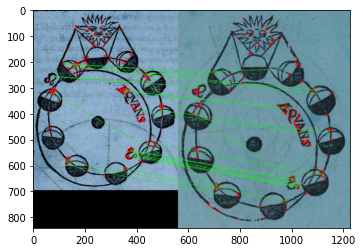

similar to 1857_giuntini_sphaera_1566_p123_493,226,664,841.jpg


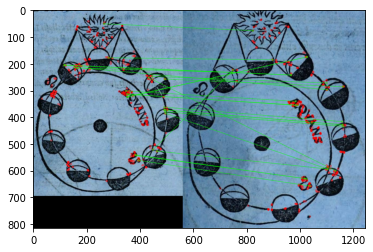

similar to 1895_melanchthon_libellus_1550_p106_125,325,685,815.jpg


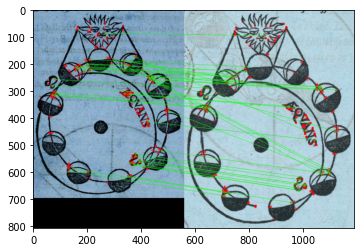

similar to 1691_sacrobosco_sphere_1546_p48_298,577,629,806.jpg


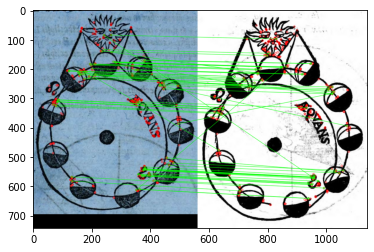

similar to 1892_farghani_sphaera_1549_p105_284,404,580,742.jpg


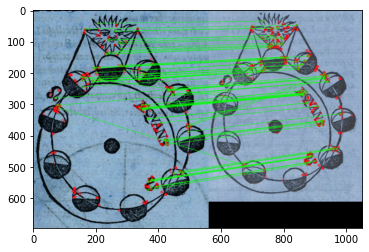

similar to 1820_clavius_sphaera_1601_p150_98,381,492,611.jpg


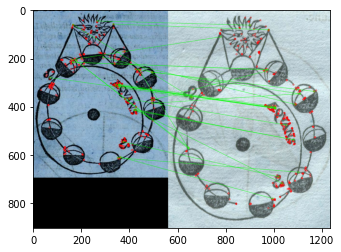

similar to 1758_desbordes_sphere_1616_p59_615,975,675,904.jpg


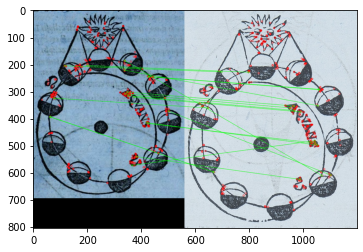

similar to 1934_sacrobosco_sphaera_1551_p71_262,327,638,805.jpg


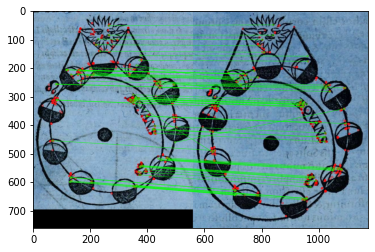

similar to 1861_gramminaeus_uberior_1567_p292_172,125,613,760.jpg


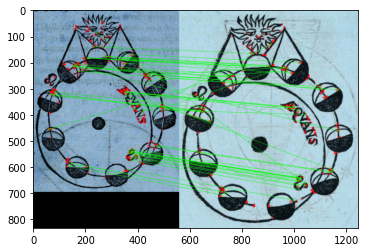

similar to 1902_vinet_sphaera_1552_p56_412,238,685,833.jpg


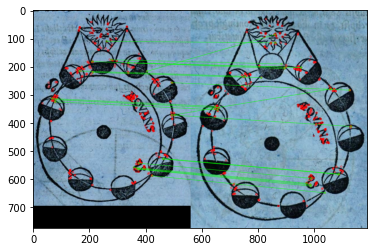

similar to 1888_melanchthon_libellus_1543_p96_113,260,630,774.jpg


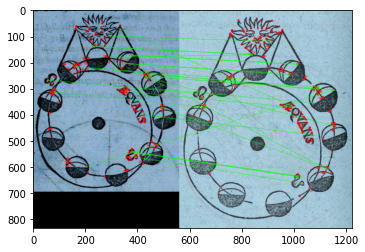

similar to 1733_sacrobosco_sphere_1576_p59_357,731,662,834.jpg


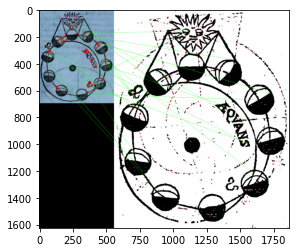

similar to 2198_sacrobosco_sphaera_1547_p76_552,353,1306,1625.jpg


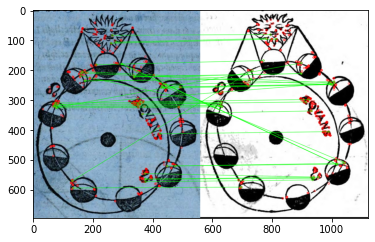

similar to 1900_sacrobosco_libellvs_1553_p99_171,252,562,692.jpg


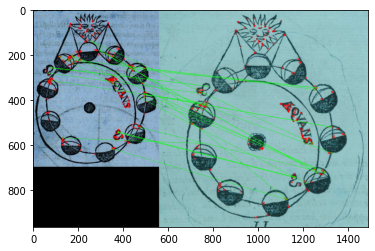

similar to 1684_sacrobosco_libellus_1543_p50_567,310,928,962.jpg


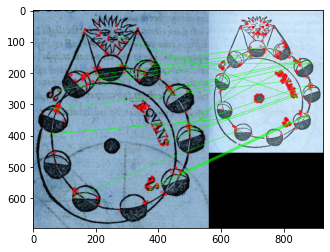

similar to 1903_sacrobosco_libellvs_1561_p98_28,179,367,455.jpg


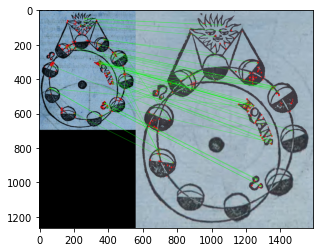

similar to 1953_vinet_sphaera_1566_p110_398,222,1033,1264.jpg


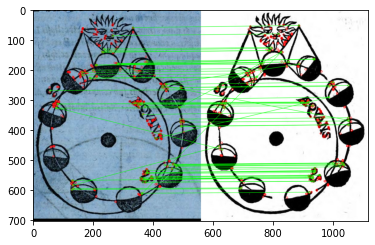

similar to 1963_sacrobosco_sphaera_1608_p110_201,189,557,703.jpg


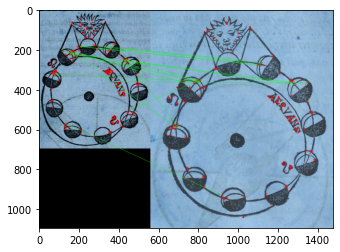

similar to 1753_sacrobosco_libellus_1601_p101_120,389,918,1094.jpg


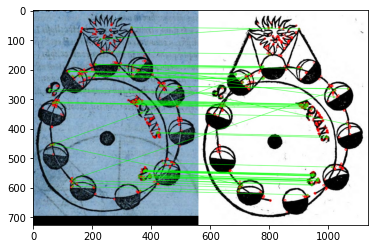

similar to 1890_melanchthon_typis_1550_p105_297,447,574,726.jpg


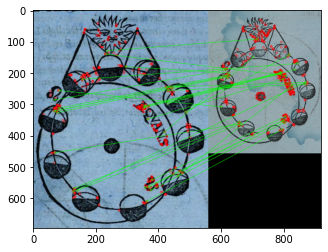

similar to 1760_sacrobosco_sphere_1619_p120_190,420,360,457.jpg


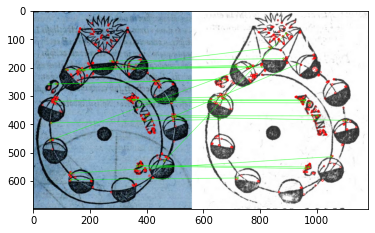

similar to 1730_giuntini_sphaera_1573_p106_151,98,621,698.jpg


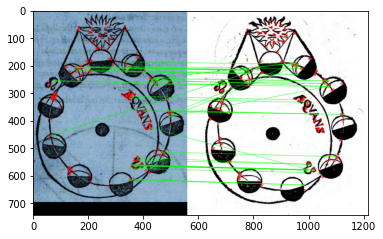

similar to 1882_sacrobosco_liber_1536_p91_286,86,656,742.jpg


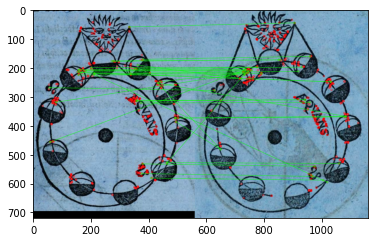

similar to 1754_desbordes_augmentee_1607_p121_314,780,600,719.jpg


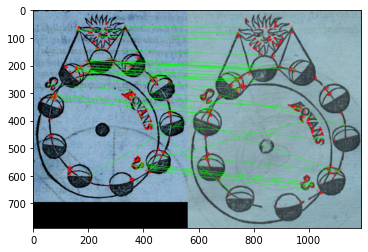

similar to 1711_vinet_sphaera_1557_p92_162,168,631,789.jpg


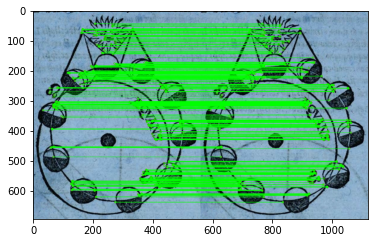

similar to 1959_vinet_sphaera_1594_p112_119,82,560,695.jpg


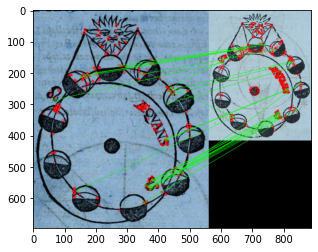

similar to 1716_ruffaut_sphaera_1561_p77_84,69,329,416.jpg


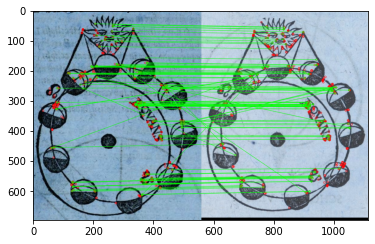

similar to 1957_clavius_sphaera_1610_p169_355,170,554,687.jpg


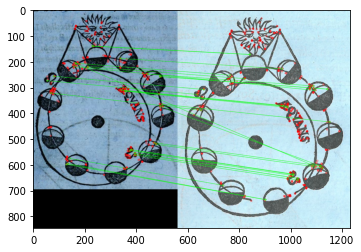

similar to 1962_vinet_sphaera_1619_p52_1576,225,672,845.jpg


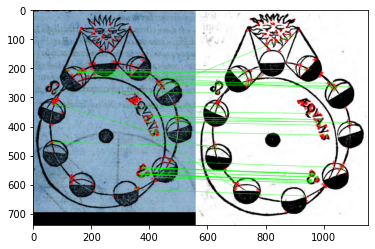

similar to 1690_sacrobosco_libellus_1545_p108_100,234,593,739.jpg


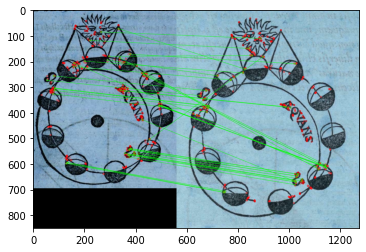

similar to 1911_nunes_sphaera_1572_p41_1553,101,716,850.jpg


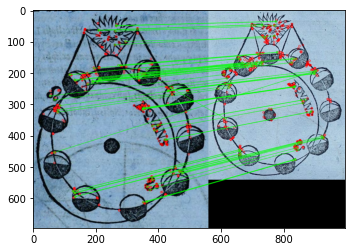

similar to 1961_vinet_sphaera_1591_p116_166,192,436,541.jpg


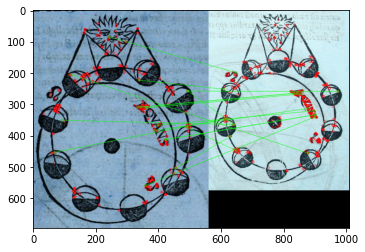

similar to 2219_sacrobosco_sphaera_1552_p59_1259,338,451,575.jpg


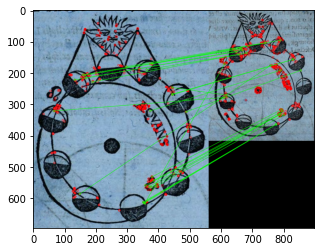

similar to 1728_vinet_sphaera_1569_p84_121,61,339,417.jpg


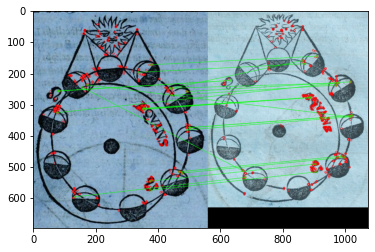

similar to 1891_sacrobosco_libellvs_1558_p99_136,310,513,629.jpg


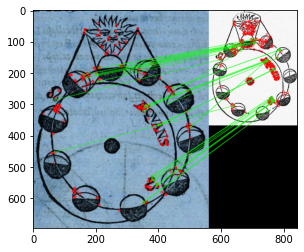

similar to 1708_vinet_sphaera_1556_p93_67,85,284,368.jpg


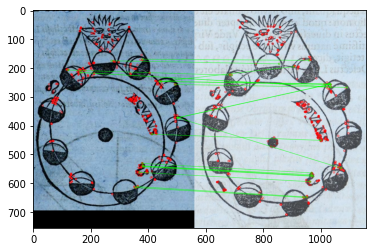

similar to 1971_sacrobosco_emendata_1586_p84_205,147,599,756.jpg


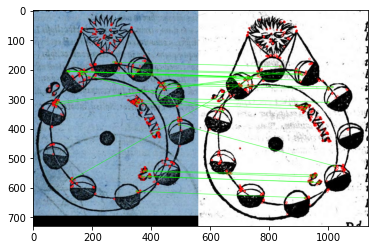

similar to 1851_giuntini_sphaeram_1577_p428_160,763,575,730.jpg


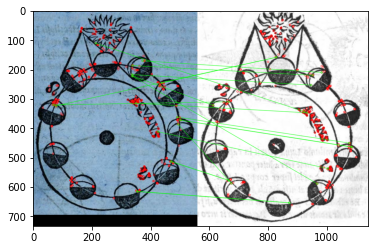

similar to 1695_sacrobosco_sphaera_1548_p63_274,431,581,733.jpg


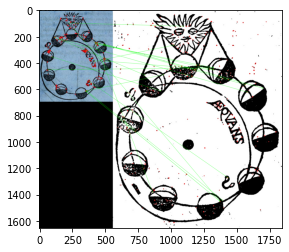

similar to 1965_vinet_sphaera_1574_p80_410,252,1283,1652.jpg


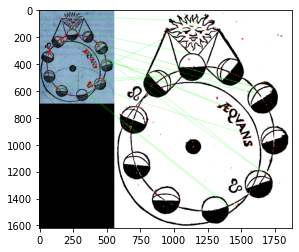

similar to 2091_melanchthon_sphaera_1531_p85_682,223,1321,1618.jpg


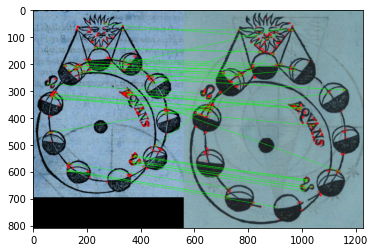

similar to 1952_vinet_sphaera_1551_p119_466,272,666,809.jpg


In [230]:
# A slightly better version with FLANN matcher

filepath = os.path.join(dataset_dir, '1959_vinet_sphaera_1594_p112_119,82,560,695.jpg')
img_1 = cv2.imread(filepath)

kp1, des1 = orb.detectAndCompute(img_1,None)


for j, filename in enumerate(os.listdir(dataset_dir)):
    
    if filename == '.DStore':
        pass
    
    else:
        filepath = os.path.join(dataset_dir, filename)
        img_2 = cv2.imread(filepath)

        kp2, des2 = orb.detectAndCompute(img_2,None)
        index_params= dict(algorithm = FLANN_INDEX_LSH,
                           table_number = 6, # 12
                           key_size = 12,     # 20
                           multi_probe_level = 1) #2

        search_params = dict(checks = 50)
        flann = cv2.FlannBasedMatcher(index_params, search_params)

        matches = flann.knnMatch(des1,des2,k=2)


        # Need to draw only good matches, so create a mask
        try:
            matchesMask = [[0,0] for i in range(len(matches))]
            good = []
            for i,(m,n) in enumerate(matches):
                if m.distance < 0.7*n.distance:
                    matchesMask[i]=[1,0]
                    good.append([m])
                    
            draw_params = dict(matchColor = (0,255,0),
                               singlePointColor = (255,0,0),
                               matchesMask = matchesMask,
                               flags = cv2.DrawMatchesFlags_DEFAULT)


            if len(good) > 16:
                img3 = cv2.drawMatchesKnn(img_1,kp1,img_2,kp2,matches,None,**draw_params)
                plt.imshow(img3,)
                plt.show()
                print('similar to {}'.format(filename))
        except:
            pass


# CNN embedding distances

## 1. Get Embedding

During training CNNs learn to build up rich representations of the input images. This can be exploited for detecting similarity by cutting a pretrained CNN at a certain layer and calculating the distance between the embeddings of two images at that layer. The smaller the distance the higher (hopefully) the similarity. The deeper (further away from input) one moves into the network  the more complex and abstract and the less local  the features that make up these representations (embeddings) become. Thus we expect that the similarity we recover with this method moves from from concrete to more abstract if we use embeddings produced deeper into the network.

#### Task:

* cut a VGG16 pretrained on image net after the fourth convolutional block, i.e at layer 13 
* calculate the embeddings for all images in the dataset

In [252]:
from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import VGG16
from keras import backend as K
from keras.layers import merge, Input
from keras.preprocessing import image



cut_layer = 14


image_input = Input(shape=(224, 224, 3))
model = VGG16(include_top=True, weights="imagenet",
              input_tensor=image_input)  

model.summary()

print('Will cut at layer {}'.format(model.layers[cut_layer].output))

inp = model.input  # input placeholder
outputs = model.layers[cut_layer].output
functor = K.function([inp, K.learning_phase()], [outputs])  # evaluation function

layer_outs_arr = []

for j, filename in enumerate(os.listdir(dataset_dir)):
    
    if filename == '.DStore':
        pass
    
    else:
        filepath = os.path.join(dataset_dir, filename)
        if (j % 100) == 0:
            print(j, filepath)

        img = image.load_img(filepath, target_size=(224, 224))
        img_data = image.img_to_array(img)
        img_data = np.expand_dims(img_data, axis=0)  # simply creates batch of size one as required by preprocess_input
        img_data = preprocess_input(img_data)
        layer_out = functor([img_data, 1])
        layer_out = np.array(layer_out)
        layer_outs_arr.append(layer_out.flatten())

    layer_outs_arr = np.array(layer_outs_arr)

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_10 (InputLayer)        (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

## 2. Clustering

#### Task:

* cluster the embeddings using k-means with  15 clusters 
* visualize some of the clusters

In [276]:
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.metrics import pairwise_distances

km = KMeans(init='k-means++', n_clusters=15, 
                        verbose=1, n_init=3, max_iter=300)
clustering = km.fit(layer_outs_arr_np)
predictions = clustering.predict(layer_outs_arr_np)

Initialization complete
Iteration 0, inertia 1157982322688.0
Iteration 1, inertia 761723879424.0
Iteration 2, inertia 747387944960.0
Iteration 3, inertia 738124431360.0
Iteration 4, inertia 730676002816.0
Iteration 5, inertia 712015806464.0
Iteration 6, inertia 698333986816.0
Iteration 7, inertia 696299028480.0
Iteration 8, inertia 695473537024.0
Iteration 9, inertia 695291543552.0
Converged at iteration 9: strict convergence.
Initialization complete
Iteration 0, inertia 1121822310400.0
Iteration 1, inertia 750114504704.0
Iteration 2, inertia 731174535168.0
Iteration 3, inertia 722442518528.0
Iteration 4, inertia 715575918592.0
Iteration 5, inertia 710557433856.0
Iteration 6, inertia 709929926656.0
Iteration 7, inertia 709761564672.0
Iteration 8, inertia 709492998144.0
Iteration 9, inertia 709311922176.0
Iteration 10, inertia 709135826944.0
Iteration 11, inertia 709113544704.0
Iteration 12, inertia 709076647936.0
Iteration 13, inertia 709020090368.0
Iteration 14, inertia 708955340800.0

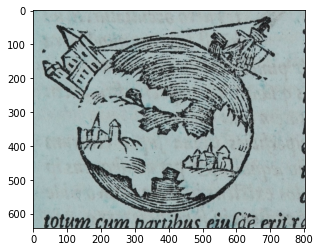

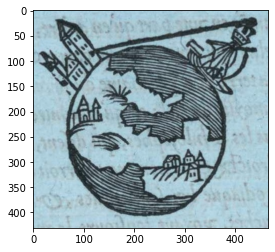

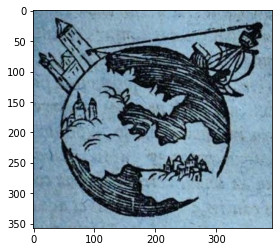

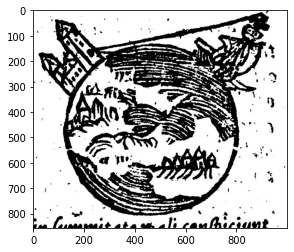

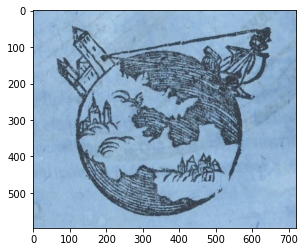

...

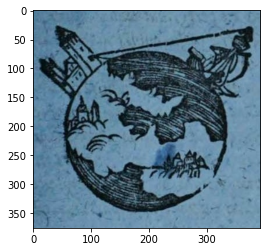

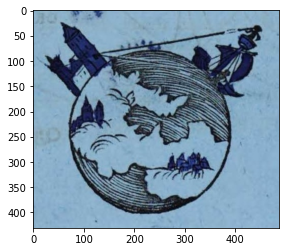

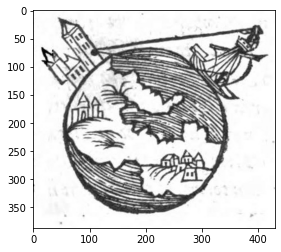

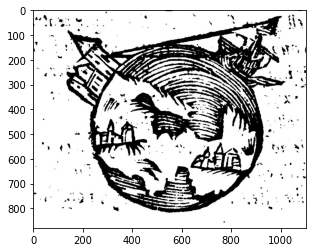

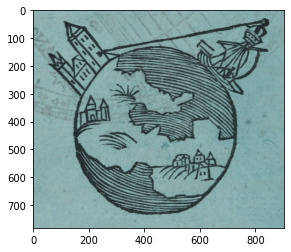

In [278]:
for image in np.array(os.listdir(dataset_dir))[np.where(predictions==0)]:
    filepath = os.path.join(dataset_dir, image)
    img = cv2.imread(filepath)
    plt.imshow(img)
    plt.show()

In [ ]:
for 